In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, Dropout, LSTM

### IMPORT DỮ LIỆU

In [6]:
def process_data(file_path):
    data = pd.read_csv(file_path, usecols=['Date/Time', 'Close', 'Volume'])
    data['Date/Time'] = pd.to_datetime(data['Date/Time'])

    return data

# Tải dữ liệu
FPT = process_data("FPT.csv")
MSN = process_data("MSN.csv")
PNJ = process_data("PNJ.csv")
VIC = process_data("VIC.csv")

In [8]:
FPT

,Date/Time,Close,Volume
0,2018-12-25 09:15:00,30.89,35410
1,2018-12-25 09:16:00,30.81,190
2,2018-12-25 09:17:00,30.74,1120
3,2018-12-25 09:18:00,30.74,2120
4,2018-12-25 09:19:00,30.74,22500
...,...,...,...
97401,2020-12-22 14:24:00,58.20,27470
97402,2020-12-22 14:25:00,58.20,14820
97403,2020-12-22 14:26:00,58.20,500
97404,2020-12-22 14:29:00,58.10,2500


In [9]:
# Tạo đồ thị tương tác
fig = go.Figure()

# Thêm dữ liệu vào đồ thị
fig.add_trace(go.Scatter(x=FPT['Date/Time'], y=FPT['Close'], mode='lines', name='FPT', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=MSN['Date/Time'], y=MSN['Close'], mode='lines', name='MSN', line=dict(color='red')))
fig.add_trace(go.Scatter(x=PNJ['Date/Time'], y=PNJ['Close'], mode='lines', name='PNJ', line=dict(color='green')))
fig.add_trace(go.Scatter(x=VIC['Date/Time'], y=VIC['Close'], mode='lines', name='VIC', line=dict(color='purple')))

# Thêm tiêu đề và nhãn trục
fig.update_layout(
    title='Giá đóng cửa của các chứng khoán',
    xaxis_title='Ngày',
    yaxis_title='Giá đóng cửa',
    legend_title='Chứng khoán',
    hovermode='x unified'
)

# Hiển thị đồ thị
fig.show()

##### Nhìn vào ta có thể tháy được giá của FPT thấp hơn các cổ phiếu còn lại  và được đưa ra thị trường trễ hơn so các mã chứng khoán còn lại. Các mã chứng khoán có xu hướng giảm và chạm đáy vào tháng 4 năm 2020. Có lẽ là do ảnh hưởng của dịch covid.

## Dự doán giá biến động giá cố phiếu theo mô hình LTMS

In [11]:
# Hàm tính biến động giá cổ phiếu
def calculate_price_change(df):
    df['Price_Change'] = df['Close'].shift(-7) - df['Close']
    return df

# Áp dụng hàm cho từng mã cổ phiếu
FPT = calculate_price_change(FPT)
MSN = calculate_price_change(MSN)
PNJ = calculate_price_change(PNJ)
VIC = calculate_price_change(VIC)

FPT.head(20)


,Date/Time,Close,Volume,Price_Change
0,2018-12-25 09:15:00,30.89,35410,0.22
1,2018-12-25 09:16:00,30.81,190,0.38
2,2018-12-25 09:17:00,30.74,1120,0.45
3,2018-12-25 09:18:00,30.74,2120,0.41
4,2018-12-25 09:19:00,30.74,22500,0.37
5,2018-12-25 09:20:00,30.74,7140,0.37
6,2018-12-25 09:21:00,30.66,16480,0.45
7,2018-12-26 09:15:00,31.11,2650,0.08
8,2018-12-26 09:16:00,31.19,500,0.00
9,2018-12-26 09:17:00,31.19,510,-0.08


In [12]:
import pandas as pd

# Giả sử 'FPT' là DataFrame với cột 'Date/Time' đã được tạo
FPT['Date/Time'] = pd.to_datetime(FPT['Date/Time'])  # Đảm bảo cột 'Date/Time' ở định dạng datetime

# Lọc DataFrame để chỉ giữ lại dữ liệu từ năm 2020 trở đi
FPT_2020 = FPT[FPT['Date/Time'] >= '2020-01-01']

# Tính toán biến động giá nếu chưa thực hiện
FPT_2020 = calculate_price_change(FPT_2020)

# Tạo DataFrame mới với cột 'Price_Change' và 'Date/Time'
FPT_data = FPT_2020[['Date/Time', 'Price_Change']]
FPT_data = FPT_data.dropna()
# Hiển thị DataFrame kết quả
print(FPT_data)


                Date/Time  Price_Change
45407 2020-01-02 09:15:00         -0.34
45408 2020-01-02 09:16:00         -0.09
45409 2020-01-02 09:17:00         -0.09
45410 2020-01-02 09:21:00         -0.09
45411 2020-01-02 09:22:00         -0.17
...                   ...           ...
97394 2020-12-22 14:17:00          0.10
97395 2020-12-22 14:18:00          0.10
97396 2020-12-22 14:19:00          0.10
97397 2020-12-22 14:20:00          0.00
97398 2020-12-22 14:21:00          0.00

[51992 rows x 2 columns]


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2616\3396656291.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [13]:
# Convert the dataframe to a numpy array
dataset =FPT_data.values
# Get the number of rows to train the model on
training_data_len = int(np.ceil( len(dataset) * .95 ))

training_data_len

49393

In [14]:
from sklearn.preprocessing import MinMaxScaler
import pandas as pd

# Lọc chỉ các cột số từ DataFrame
FPT_data_numeric = FPT_data.select_dtypes(include=[float, int])

# Chuyển đổi DataFrame thành array để chuẩn hóa
FPT_data_arr = FPT_data_numeric.values
# Scale the data
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0,1))
scaled_data = scaler.fit_transform(FPT_data_arr)

scaled_data



array([[0.48761905],
       [0.5352381 ],
       [0.5352381 ],
       ...,
       [0.57142857],
       [0.55238095],
       [0.55238095]])

In [15]:
# Create the scaled training data set
train_data = scaled_data[0:int(training_data_len), :]
# Split the data into x_train and y_train data sets
x_train = []
y_train = []

for i in range(60, len(train_data)):
    x_train.append(train_data[i-60:i, 0])
    y_train.append(train_data[i, 0])
    if i<= 61:
        print(x_train)
        print(y_train)
        print()
        
# Convert the x_train and y_train to numpy arrays 
x_train, y_train = np.array(x_train), np.array(y_train)

# Reshape the data
x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], 1))
# x_train.shape

[array([0.48761905, 0.5352381 , 0.5352381 , 0.5352381 , 0.52      ,
       0.52      , 0.56761905, 0.6       , 0.55238095, 0.53714286,
       0.55238095, 0.5847619 , 0.5847619 , 0.56952381, 0.56952381,
       0.56952381, 0.5847619 , 0.58666667, 0.5847619 , 0.56952381,
       0.56952381, 0.56952381, 0.55238095, 0.56952381, 0.5352381 ,
       0.53714286, 0.55238095, 0.55238095, 0.5352381 , 0.55238095,
       0.55238095, 0.5352381 , 0.51809524, 0.55238095, 0.5352381 ,
       0.56952381, 0.55238095, 0.55238095, 0.56952381, 0.56952381,
       0.5352381 , 0.55238095, 0.51809524, 0.5352381 , 0.51809524,
       0.5352381 , 0.5352381 , 0.55238095, 0.55238095, 0.55238095,
       0.55238095, 0.55238095, 0.55238095, 0.55238095, 0.55238095,
       0.55238095, 0.56952381, 0.56952381, 0.55238095, 0.56952381])]
[0.5695238095238099]

[array([0.48761905, 0.5352381 , 0.5352381 , 0.5352381 , 0.52      ,
       0.52      , 0.56761905, 0.6       , 0.55238095, 0.53714286,
       0.55238095, 0.5847619 , 0.584

In [16]:
import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, LSTM

# Build the LSTM model
model = Sequential()
model.add(LSTM(128, return_sequences=True, input_shape= (x_train.shape[1], 1)))
model.add(LSTM(64, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(x_train, y_train, batch_size=1, epochs=1)

C:\Users\ASUS\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



49333/49333 ━━━━━━━━━━━━━━━━━━━━ 3877s 78ms/step - loss: 8.4175e-04


In [19]:

test_data = scaled_data[training_data_len - 60: , :]
# Create the data sets x_test and y_test
x_test = []
y_test = dataset[training_data_len:, :]
for i in range(60, len(test_data)):
    x_test.append(test_data[i-60:i, 0])
    
# Convert the data to a numpy array
x_test = np.array(x_test)

# Reshape the data
x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1 ))

# Get the models predicted price values 
predictions = model.predict(x_test)
predictions = scaler.inverse_transform(predictions)

82/82 ━━━━━━━━━━━━━━━━━━━━ 3s 35ms/step


In [20]:
# Chuyển đổi y_test thành mảng NumPy nếu chưa phải
y_test = np.array(y_test)

# Chọn cột thứ hai từ y_test
y_test = y_test[:, 1]

# Đảm bảo y_test có cùng kích thước với predictions
# Nếu predictions có kích thước (số mẫu, 1), ta cần điều chỉnh y_test cho phù hợp
y_test = np.reshape(y_test, (predictions.shape[0], -1))

# Tính toán RMSE
rmse = np.sqrt(np.mean((predictions - y_test) ** 2))
print("RMSE:", rmse)


RMSE: 0.10068490303793651


C:\Users\ASUS\AppData\Local\Temp\ipykernel_2616\4132142073.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



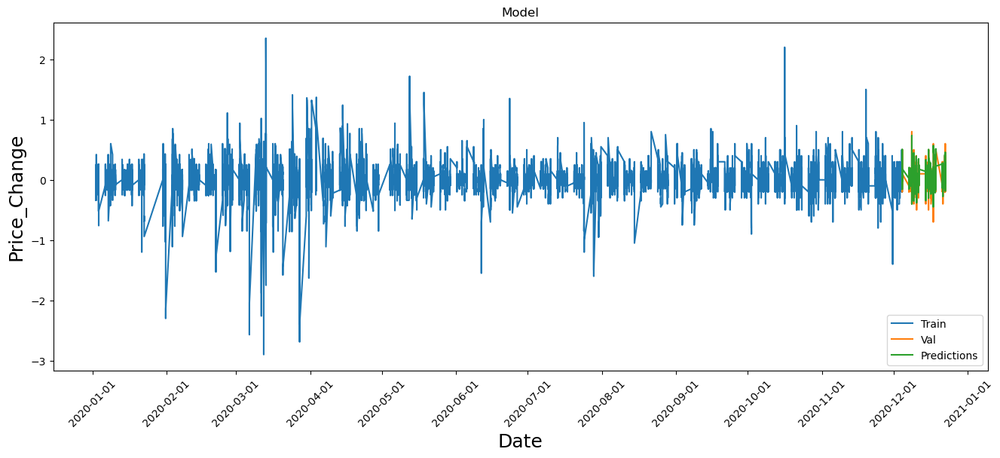

In [21]:
 import matplotlib.dates as mdates
train = FPT_data[:training_data_len]
valid = FPT_data[training_data_len:]
valid['Predictions'] = predictions
# Visualize the data
plt.figure(figsize=(16,6))
plt.title('Model')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Price_Change', fontsize=18)
# Vẽ các đường biểu diễn
plt.plot(train['Date/Time'], train['Price_Change'], label='Train')
plt.plot(valid['Date/Time'], valid['Price_Change'], label='Val')
plt.plot(valid['Date/Time'], valid['Predictions'], label='Predictions')

# Định dạng trục x
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))  
plt.gca().xaxis.set_major_locator(mdates.MonthLocator()) 

plt.legend(loc='lower right')
plt.xticks(rotation=45)  
plt.show() 